In [2]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.neighbors import NearestNeighbors
import pandas as pd
from pandas.plotting import register_matplotlib_converters
import os
import math
from sklearn.cluster import KMeans
from sklearn.metrics import precision_score
import seaborn as sns
from sklearn import metrics
from tqdm import tqdm
import time
import pickle
import metric_learn
from sklearn.decomposition import PCA  
from sklearn import cluster, datasets, mixture
from sklearn.neighbors import LocalOutlierFactor

In [2]:
plt.rcParams["font.size"] = 20
plt.rcParams["font.family"] = "Times New Roman"
def make_data(x, str,w):
    x=pd.DataFrame(x)
    window=w
    for i in range(1, window):
        column=f'{str}_lag{i}'
        x[column]=x[str].shift(i)
    return x

def make_label(x, w):
    window=w
    x['label_all']=x['label']
    for i in range(1, window):
        x.loc[(x['label_all']==1)|(x['label'].shift(i)==1), 'label_all']=1
        x.loc[(x['label_all']==0)&(x['label'].shift(i)==0), 'label_all']=0
    
    x['label']=x['label_all']
    return x[['label']]

def calc_leq(df, unit):
    df.reset_index(inplace=True, drop=True)
    for i in range(int(len(df)/unit)+1):
        hour_df=df.loc[i*unit:(i+1)*unit, 'original'].copy()
        N=len(hour_df)
        Leq=10*np.log10(np.sum(np.power(10, hour_df/10)))-10*np.log10(N)
        df.loc[i*unit:(i+1)*unit, 'leq']=Leq
    return df

def leq_filter(df):
    df=calc_leq(df, 18000)
    df.loc[(df['original']<df['leq']), 'd']=0
    return df

def validate(test_v, anorm, thr=0.2):
    test_v['z']=np.where(anorm>=thr, 1, 0)
    test_v.reset_index(inplace=True, drop=True)

    #     適合率
    tp=test_v[(test_v['label']==1)&(test_v['z']==1)]
    z_p=test_v[test_v['z']==1]
    pre_score=len(tp)/len(z_p)

    #     再現率
    df_anorm=[]
    search= 1 if test_v.loc[0, 'label']==0 else 0
    for num in range(len(test_v)):
        if search==1 and test_v.loc[num, 'label']==search:
            start=num
            search=0
        elif search==0 and test_v.loc[num, 'label']==search:
            stop=num-1
            anorm_range=test_v.loc[start:stop].copy()
            df_anorm.append(anorm_range)
            search=1
            
    count=[]
    for i in range(len(df_anorm)):
        if len(df_anorm[i].loc[df_anorm[i]['z']==1])>=1:
               count.append(i)    

    re_score=len(count)/len(df_anorm)

    return pre_score, re_score

def figure(df_test, d, thr):
    plt.rcParams["font.size"] = 20
    plt.rcParams["font.family"] = "Times New Roman"
    df_test=df_test.copy()
    df_test['z']=np.where(d>=thr, 1, 0)
    
    z=df_test['z'].values*100
    test_plot=df_test['original'].values
    num_ax=math.ceil(len(test_plot)/17999)
    label=df_test['label'].values*100
    label_index=range(len(label))
    time_unit=60
    time=[t*0.2/60 for t in range(len(d))]
    time_unit_data=18000
    fig, ax=plt.subplots(num_ax, 1, figsize=(35, 16*num_ax))
    plt.subplots_adjust(hspace=0.35)
    for i in range(num_ax):
        ax[i].plot(time[i*time_unit_data:time_unit_data*(i+1)], d[i*time_unit_data:time_unit_data*(i+1)], '-r',linewidth = 1, label='異常度')
        ax[i].fill_between(time[i*time_unit_data:time_unit_data*(i+1)], label[i*time_unit_data:time_unit_data*(i+1)], facecolor='lime', label='異常ラベル' )

#         #異常と判別したところを強調したい場合
#         ax[i].fill_between(time[i*time_unit_data:time_unit_data*(i+1)], z[i*time_unit_data:time_unit_data*(i+1)], facecolor='steelblue' )
        
        ax2=ax[i].twinx()
        ax2.plot(time[i*time_unit_data:time_unit_data*(i+1)], test_plot[i*time_unit_data:time_unit_data*(i+1)], '-k',linewidth = 2, label='騒音レベル')

        ax[i].set_xticks(np.arange(60*i, 60*(i+1),3))
        ax[i].set_xticklabels(np.arange(60*i, 60*(i+1),3), fontsize=40)
        ax[i].xaxis.set_tick_params(rotation=30)
        ax[i].set_xlim(i*time_unit, time_unit*(i+1))
        
        ax[i].set_yticks(np.arange(0, 12, 2)/10)
        ax[i].set_yticklabels(np.arange(0, 12, 2)/10, fontsize=40)
        
        ax2.set_yticks(np.arange(40, 90, 10))
        ax2.set_yticklabels(np.arange(40, 90, 10), fontsize=40)
        
        ax[i].set_ylim(0, 2)
        ax2.set_ylim(10, 80)
        h1, l1 = ax[i].get_legend_handles_labels()
        h2, l2 = ax2.get_legend_handles_labels()
        ax[i].legend(h2+h1, l2+l1, loc='lower center', bbox_to_anchor=(.5, 1.0), ncol=3, prop={'family':"MS Mincho", 'size':40})
        ax[i].set_xlabel('時点(分)', fontfamily="MS Mincho",fontsize=40)
        ax[i].set_ylabel('　　　異常度', fontfamily="MS Mincho",fontsize=40, loc='bottom')
        ax2.set_ylabel('　騒音レベル値(dB)', fontfamily="MS Mincho",fontsize=40, loc='top')
    plt.show()
    return df_test

def figure_detail(df_test, d_test, start=0, stop=60):
    plt.rcParams["font.size"] = 20
    plt.rcParams["font.family"] = "Times New Roman"
    
    start_data=int(math.floor(start)*60/0.2)
    stop_data=int(math.ceil(stop)*60/0.2)

    test_plot=df_test['original'].values[start_data:stop_data]
    d=d_test[start_data:stop_data]
    label=df_test['label'].values[start_data:stop_data]*100
    label_index=range(len(label))

    time=[t*0.2/60 for t in range(start_data, stop_data)]
    fig, ax=plt.subplots(1, 1, figsize=(35, 16))

    ax.plot(time, test_plot, '-k',linewidth = 2, label='騒音レベル')
    ax2=ax.twinx()
    ax2.plot(time, d, '-r',linewidth = 2, label='異常度')
    ax.fill_between(time, label, facecolor='lime', label='異常ラベル' )

    ax.set_xticks(np.arange(math.floor(start), math.ceil(stop), 1))
    ax.set_xticklabels(np.arange(math.floor(start), math.ceil(stop), 1), fontsize=50)
#     ax.xaxis.set_tick_params(rotation=30)
    ax.set_xlim(start, stop)

    ax.set_yticks(np.arange(40, 90, 10))
    ax.set_yticklabels(np.arange(40, 90, 10), fontsize=50)        
    ax.set_ylim(40, 80)
    
    ax2.set_yticks(np.arange(0, 12, 2)/10)
    ax2.set_yticklabels(np.arange(0, 12, 2)/10, fontsize=50)

    ax2.set_ylim(0, 2)
    ax.set_ylim(10, 80)

    h1, l1 = ax.get_legend_handles_labels()
    h2, l2 = ax2.get_legend_handles_labels()
    ax.legend(h2+h1, l2+l1, loc='lower center', bbox_to_anchor=(.5, 1.0), ncol=3, prop={'family':"MS Mincho", 'size':53})
    ax.set_xlabel('時点(分)', fontfamily="MS Mincho",fontsize=53)
    ax.set_ylabel('騒音レベル値(dB)　', fontfamily="MS Mincho",fontsize=53, loc='top')
    ax2.set_ylabel('　　　異常度', fontfamily="MS Mincho",fontsize=53, loc='bottom')
    plt.show()    
    
def fig_pr(test_v, d, bins):
    plt.rcParams["font.size"] = 15
    plt.rcParams["font.family"] = "Times New Roman"
    bins_1=int(bins*0.8)
    thr_1=np.linspace(d.min(), 0.6, bins_1)
    thr_2=np.linspace(0.6, d.max(), bins-bins_1)
    thresholds=np.concatenate([thr_1, thr_2])
    precision=np.array([])
    recall=np.array([])
    for i in thresholds:
        p, r=validate(test_v, d, i)
        precision=np.append(precision, p)
        recall=np.append(recall, r)

    auc = metrics.auc(recall, precision)
    f_score=(2*precision*recall)/(precision+recall)
    thr=thresholds[np.argmax(f_score)]

#     #F値が最大になる点を明示したい場合
#     plt.plot(recall, precision, marker='o', markevery=[np.argmax(f_score)], label='PR curve (AUC = %.2f)'%auc)
    #明示しなくていい場合
    plt.plot(recall, precision, '-k',linewidth = 2, label='PR曲線')
    
#     plt.legend(prop={'family':"MS Mincho"}, loc="lower left")
    plt.xlabel('再現率', fontfamily="MS Mincho")
    plt.ylabel('適合率', fontfamily="MS Mincho")
    plt.grid(True)
    plt.show()

    return precision, recall, f_score, thresholds, thr, auc

def auc_gs(test_v, d, bins):
    bins_1=int(bins*0.8)
    thr_1=np.linspace(d.min(), 0.6, bins_1)
    thr_2=np.linspace(0.6, d.max(), bins-bins_1)
    thresholds=np.concatenate([thr_1, thr_2])
    precision=np.array([])
    recall=np.array([])
    for i in thresholds:
        p, r=validate(test_v, d, i)
        precision=np.append(precision, p)
        recall=np.append(recall, r)

    auc = metrics.auc(recall, precision)

    return auc

def fig_th_f(thresholds, f_score):
    plt.rcParams["font.size"] = 20
    plt.rcParams["font.family"] = "Times New Roman"
    plt.plot(thresholds, f_score, marker="o", markevery=[np.argmax(f_score)])
    plt.xlabel('thresholds')
    plt.ylabel('f_score')
    plt.grid(True)
    plt.show()
    
    return thresholds[np.argmax(f_score)], f_score.max()

In [3]:
data_dir='filtered_csv_label'
original = pd.read_csv( os.path.join(data_dir, 'learning_data_10.csv') )
df = pd.read_csv( os.path.join(data_dir, 'learning_data_10.csv') )
df=df[df['day']<=9]
df

,original,label,time,day
0,53.4,0,15,0
1,52.8,0,15,0
2,52.8,0,15,0
3,53.2,0,15,0
4,53.6,0,15,0
...,...,...,...,...
3995345,45.9,0,5,9
3995346,45.6,0,5,9
3995347,45.8,0,5,9
3995348,45.7,0,5,9


# ホールドアウト検証
## 訓練、テストへ分割
* テスト（最終評価用）：6, 7, 8, 9 日目
---
ラベル付け
* 全体：0, 1, 2, 3, 4, 5 日目
* 訓練ローテ：(訓練、ラベル付与対象)=([0, 1, 2, 3, 4], 5)・・・([5, 0, 1, 2, 3], 4)

In [4]:
best_params={'window': 5, 'nk': 12}

In [5]:
test_day=[6, 7, 8, 9]
semi_train_day=[0, 1, 2, 3, 4, 5]

test_df=df[(df['day'].isin(test_day))].reset_index(drop=True)
semi_train_df=df[(df['day'].isin(semi_train_day))].reset_index(drop=True)

In [6]:
df_list=[]

window=best_params['window']
for i in set(df['day']):
    lag=[] 
    lag.append(make_data(semi_train_df.loc[semi_train_df['day']==i, ['original']], 'original', window))
    lag.append(semi_train_df.loc[semi_train_df['day']==i, ['day']])
    lag.append(semi_train_df.loc[semi_train_df['day']==i, ['label']])
    df_add_lag=pd.concat(lag, axis=1)
    df_list.append(df_add_lag)
semi_train_df=pd.concat(df_list)
semi_train_df=semi_train_df.dropna().reset_index(drop=True)
semi_train_df.loc[:, 'pred']=0

In [7]:
semi_train_df

,original,original_lag1,original_lag2,original_lag3,original_lag4,day,label,pred
0,53.6,53.2,52.8,52.8,53.4,0,0,0
1,54.0,53.6,53.2,52.8,52.8,0,0,0
2,54.7,54.0,53.6,53.2,52.8,0,0,0
3,55.7,54.7,54.0,53.6,53.2,0,0,0
4,55.5,55.7,54.7,54.0,53.6,0,0,0
...,...,...,...,...,...,...,...,...
2393381,45.0,45.4,45.1,44.8,45.4,5,0,0
2393382,45.2,45.0,45.4,45.1,44.8,5,0,0
2393383,45.1,45.2,45.0,45.4,45.1,5,0,0
2393384,45.1,45.1,45.2,45.0,45.4,5,0,0


## DBSCAN

In [7]:
semi_train_df['scaned']=0
# 自己一致を避けるために10ステップ間隔で系統抽出
step=10
for i in range(step):
    dataset=semi_train_df[semi_train_df.columns[:-4]][i::step]
    index=list(dataset.index)
    dbscan_dataset= cluster.DBSCAN(eps=0.3, min_samples=10, metric='euclidean').fit_predict(dataset.values)
    semi_train_df.loc[index, 'scaned']=dbscan_dataset

In [25]:
labeling_day_num=1
cv_comb=np.array(semi_train_day).reshape((-1, labeling_day_num)).tolist()
cv_comb

[[0], [1], [2], [3], [4], [5]]

## （教師なし）K近傍法でラベル付与

In [11]:
for i in cv_comb:
    label_train_day=[k for k in semi_train_day if k not in i]
    label_grant_day=i
    print(f'訓練データ：{label_train_day}')
    print(f'ラベル付与データ：{label_grant_day}日目')

    semi_train_x=semi_train_df[(semi_train_df['day'].isin(label_train_day))&(semi_train_df['scaned']==0)][semi_train_df.columns[:-4]].reset_index(drop=True)
    labeling_x=semi_train_df[(semi_train_df['day'].isin(label_grant_day))][semi_train_df.columns[:-4]].reset_index(drop=True)

    nk = best_params['nk']
    neigh = NearestNeighbors(n_neighbors=nk)
    neigh.fit(semi_train_x)
    d = neigh.kneighbors(labeling_x)[0]
    d = np.mean(d, axis=1)
    
    semi_train_df.loc[semi_train_df['day'].isin(label_grant_day), 'pred']=d
    
    #閾値設定
    #kmeans
    n_clusters=2
    #init default=’k-means++’
    model = KMeans(n_clusters=n_clusters, n_init=10)  
    model.fit(d.reshape((-1, 1)))
    clusters = model.predict(d.reshape((-1, 1)))  
    result=pd.DataFrame({'d':d, 'cluster':clusters})
    thr_list=[]
    for j in range(n_clusters):
        thr_list.append(result.loc[result['cluster']==j, 'd'].max())
    thr_min=sorted(thr_list)[-2]
    thr_max=sorted(thr_list)[-1]
    thr_range=result.loc[(result['d']>thr_min)&(result['d']<=thr_max), ['d']]
    Q1 = float(thr_range.quantile(0.25).iloc[0])
    Q3 = float(thr_range.quantile(0.75).iloc[0])
    IQR = Q3 - Q1
    thr = min(float(Q3 + 1.5 * IQR), thr_max)
    
    semi_train_df.loc[semi_train_df['day'].isin(label_grant_day), 'pred']\
    = np.where(semi_train_df.loc[semi_train_df['day'].isin(label_grant_day), 'pred']>=thr, 1, 0)
    print('------------------------------------------------------')
semi_train_df_tmp=semi_train_df[['original', 'day', 'pred', 'label', 'scaned']]

訓練データ：[1, 2, 3, 4, 5]
ラベル付与データ：[0]日目
------------------------------------------------------
訓練データ：[0, 2, 3, 4, 5]
ラベル付与データ：[1]日目
------------------------------------------------------
訓練データ：[0, 1, 3, 4, 5]
ラベル付与データ：[2]日目
------------------------------------------------------
訓練データ：[0, 1, 2, 4, 5]
ラベル付与データ：[3]日目
------------------------------------------------------
訓練データ：[0, 1, 2, 3, 5]
ラベル付与データ：[4]日目
------------------------------------------------------
訓練データ：[0, 1, 2, 3, 4]
ラベル付与データ：[5]日目
------------------------------------------------------


In [12]:
semi_train_df

,original,original_lag1,original_lag2,original_lag3,original_lag4,day,label,pred,scaned
0,53.6,53.2,52.8,52.8,53.4,0,0,0.0,0
1,54.0,53.6,53.2,52.8,52.8,0,0,0.0,0
2,54.7,54.0,53.6,53.2,52.8,0,0,0.0,0
3,55.7,54.7,54.0,53.6,53.2,0,0,0.0,-1
4,55.5,55.7,54.7,54.0,53.6,0,0,0.0,-1
...,...,...,...,...,...,...,...,...,...
2393381,45.0,45.4,45.1,44.8,45.4,5,0,0.0,0
2393382,45.2,45.0,45.4,45.1,44.8,5,0,0.0,0
2393383,45.1,45.2,45.0,45.4,45.1,5,0,0.0,0
2393384,45.1,45.1,45.2,45.0,45.4,5,0,0.0,0


## この時点で異常か正常か判別できないデータはLOFで判別

In [13]:
# ほぼ確実に正常なデータ
semi_train_0=semi_train_df[(semi_train_df['scaned']==0)][semi_train_df.columns[:-4]]
# ほぼ確実に異常なデータ
semi_train_1=semi_train_df[(semi_train_df['pred']==1)][semi_train_df.columns[:-4]]

In [14]:
# この時点で異常か正常か判別できないデータ
unidentified=semi_train_df[(semi_train_df['scaned']!=0)&(semi_train_df['pred']!=1)][semi_train_df.columns[:-4]]

In [15]:
model_normal = LocalOutlierFactor(n_neighbors=12,
                           novelty=True)
model_abnormal = LocalOutlierFactor(n_neighbors=12,
                           novelty=True)

## 正常と仮定した場合の外れ値度

In [16]:
model_normal.fit(semi_train_0.values) 
score_normal = model_normal.score_samples(unidentified.values)
score_normal

array([-1.02823957, -1.22288695, -1.094991  , ..., -1.30618321,
       -1.69554473, -1.37643751])

## 異常と仮定した場合の外れ値度

In [17]:
model_abnormal.fit(semi_train_1.values)
score_abnormal = model_abnormal.score_samples(unidentified.values)
score_abnormal

array([-1.54311595, -1.4958807 , -1.31451553, ..., -2.32285211,
       -2.29757883, -2.29768585])

In [18]:
semi_train_df['lof_normal']=0
semi_train_df['lof_abnormal']=0

In [19]:
semi_train_df.loc[unidentified.index, 'lof_normal']=score_normal
semi_train_df.loc[unidentified.index, 'lof_abnormal']=score_abnormal

In [20]:
semi_train_df.loc[semi_train_df['lof_normal']<semi_train_df['lof_abnormal'], 'lofed']=1
semi_train_df.loc[semi_train_df['lof_normal']>=semi_train_df['lof_abnormal'], 'lofed']=0
semi_train_df.drop(columns=['lof_normal', 'lof_abnormal'], inplace=True)
semi_train_df

,original,original_lag1,original_lag2,original_lag3,original_lag4,day,label,pred,scaned,lofed
0,53.6,53.2,52.8,52.8,53.4,0,0,0.0,0,0.0
1,54.0,53.6,53.2,52.8,52.8,0,0,0.0,0,0.0
2,54.7,54.0,53.6,53.2,52.8,0,0,0.0,0,0.0
3,55.7,54.7,54.0,53.6,53.2,0,0,0.0,-1,0.0
4,55.5,55.7,54.7,54.0,53.6,0,0,0.0,-1,0.0
...,...,...,...,...,...,...,...,...,...,...
2393381,45.0,45.4,45.1,44.8,45.4,5,0,0.0,0,0.0
2393382,45.2,45.0,45.4,45.1,44.8,5,0,0.0,0,0.0
2393383,45.1,45.2,45.0,45.4,45.1,5,0,0.0,0,0.0
2393384,45.1,45.1,45.2,45.0,45.4,5,0,0.0,0,0.0


### ・pred:0⇒おそらく正常 / 1⇒ほぼ確実に異常
### ・scaned:0⇒ほぼ確実に正常 / 0以外(-1など)⇒おそらく異常
## 上記の中で，正常か異常かあいまいなやつをlofで分別
### ・lofed:0⇒正常 / 1⇒異常

## 半教師あり学習結果を保存

In [22]:
semi_train_df_tmp=semi_train_df[['original', 'day', 'pred', 'label', 'scaned', 'lofed']]
semi_train_df_tmp.to_csv('semi_train_data/semi_train_df.csv')

## 半教師あり学習結果読み込み

In [3]:
semi_train_df= pd.read_csv('semi_train_data/semi_train_df.csv', index_col=0)
semi_train_df

,original,day,label,pred,pred_label,svded,svd_label
0,53.6,0,0,0.017504,0.0,9.346915e-15,0.0
1,54.0,0,0,0.013260,0.0,9.346915e-15,0.0
2,54.7,0,0,0.014384,0.0,9.346915e-15,0.0
3,55.7,0,0,0.015941,0.0,9.346915e-15,0.0
4,55.5,0,0,0.020775,0.0,9.346915e-15,0.0
...,...,...,...,...,...,...,...
2393381,45.0,5,0,0.001095,0.0,1.093260e-03,0.0
2393382,45.2,5,0,0.000896,0.0,8.774267e-04,0.0
2393383,45.1,5,0,0.000449,0.0,9.074132e-04,0.0
2393384,45.1,5,0,0.000349,0.0,6.844524e-04,0.0


## 特異スペクトル変換

In [24]:
best_params={'w': 6, 'l': 2, 'd': 2}

In [25]:
def svd_data(lst, dim):
    lst=pd.DataFrame(lst)
    lst.columns=['data']
    window=dim
    str='data'
    for i in range(1, window):
        column=f'{str}_lag{i}'
        lst[column]=lst[str].shift(i)
    lst=lst.dropna().reset_index(drop=True)
    return lst.values

In [26]:
test=semi_train_df.copy()
test

,original,day,pred,label,scaned,lofed
0,53.6,0,0.0,0,0,0.0
1,54.0,0,0.0,0,0,0.0
2,54.7,0,0.0,0,0,0.0
3,55.7,0,0.0,0,-1,0.0
4,55.5,0,0.0,0,-1,0.0
...,...,...,...,...,...,...
2393381,45.0,5,0.0,0,0,0.0
2393382,45.2,5,0.0,0,0,0.0
2393383,45.1,5,0.0,0,0,0.0
2393384,45.1,5,0.0,0,0,0.0


In [27]:
#特徴量とラベルに分割
test_x = test['original']
test_y = test['label']

#処理時間の計測
time_start=time.perf_counter()

#窓幅（列数）
w =best_params['w']
#行数
l = best_params['l']
#テスト行列と履歴行列をどれだけずらすか
d =best_params['d']
#それぞれ（テスト、履歴）の直行行列の最初のm列目までを使う
m = 2
#データ数
T = len(test_x)
sv = [0 for i in range(0, T)]

for s in range(l+w-1, T-d):
    if s%100000==0:
        print(s)
        
    H1 = svd_data(test_x[s-w-l+1:s].values, w).T
    Htest = svd_data(test_x[s-w-l+1+d:s+d].values, w).T
    U1 =  np.linalg.svd(H1)[0]
    U2 =  np.linalg.svd(Htest)[0]
    e  =  np.linalg.svd(np.dot(U1[:, 0:m].T , U2[:, 0:m]))[1]
    ab = e[0]
    sv[s+1] = (1 - ab*ab)

test.loc[:, 'svded']=sv
test

100000
200000
300000
400000
500000
600000
700000
800000
900000
1000000
1100000
1200000
1300000
1400000
1500000
1600000
1700000
1800000
1900000
2000000
2100000
2200000
2300000


,original,day,pred,label,scaned,lofed,svded
0,53.6,0,0.0,0,0,0.0,0.000000
1,54.0,0,0.0,0,0,0.0,0.000000
2,54.7,0,0.0,0,0,0.0,0.000000
3,55.7,0,0.0,0,-1,0.0,0.000000
4,55.5,0,0.0,0,-1,0.0,0.000000
...,...,...,...,...,...,...,...
2393381,45.0,5,0.0,0,0,0.0,0.000031
2393382,45.2,5,0.0,0,0,0.0,0.000025
2393383,45.1,5,0.0,0,0,0.0,0.000026
2393384,45.1,5,0.0,0,0,0.0,0.000019


## 半教師あり学習の結果を保存

In [ ]:
test.to_csv('semi_train_data/semi_train_df.csv')

## 半教師あり学習の結果を読み込み

In [112]:
semi_train_df= pd.read_csv('semi_train_data/semi_train_df.csv', index_col=0)
semi_train_df

,original,day,pred,label,scaned,lofed,svded,svd_label
0,53.6,0,0.0,0,0,0.0,0.000000,0.0
1,54.0,0,0.0,0,0,0.0,0.000000,0.0
2,54.7,0,0.0,0,0,0.0,0.000000,0.0
3,55.7,0,0.0,0,-1,0.0,0.000000,0.0
4,55.5,0,0.0,0,-1,0.0,0.000000,0.0
...,...,...,...,...,...,...,...,...
2393381,45.0,5,0.0,0,0,0.0,0.000031,0.0
2393382,45.2,5,0.0,0,0,0.0,0.000025,0.0
2393383,45.1,5,0.0,0,0,0.0,0.000026,0.0
2393384,45.1,5,0.0,0,0,0.0,0.000019,0.0


In [238]:
labeling_day_num=1
cv_comb=np.array(semi_train_day).reshape((-1, labeling_day_num)).tolist()
for i in cv_comb:
    label_grant_day=i
    print(f'ラベル付与データ：{label_grant_day}日目')
    d=semi_train_df.loc[(semi_train_df['day'].isin(label_grant_day)), 'svded'].values

    #閾値設定
    #kmeans
    n_clusters=2
    #init default=’k-means++’
    model = KMeans(n_clusters=n_clusters, n_init=10)  
    model.fit(d.reshape((-1, 1)))
    clusters = model.predict(d.reshape((-1, 1)))  
    result=pd.DataFrame({'d':d, 'cluster':clusters})
    thr_list=[]
    for j in range(n_clusters):
        thr_list.append(result.loc[result['cluster']==j, 'd'].max())
    thr=sorted(thr_list)[-2]


    semi_train_df.loc[semi_train_df['day'].isin(label_grant_day), 'svd_label']\
    = np.where(semi_train_df.loc[semi_train_df['day'].isin(label_grant_day), 'svded']>=thr, 1, 0)
print('------------------------------------------------------')

ラベル付与データ：[0]日目
ラベル付与データ：[1]日目
ラベル付与データ：[2]日目
ラベル付与データ：[3]日目
ラベル付与データ：[4]日目
ラベル付与データ：[5]日目
------------------------------------------------------


In [239]:
semi_train_df

,original,day,pred,label,scaned,lofed,svded,svd_label
0,53.6,0,0.0,0,0,0.0,0.000000,0.0
1,54.0,0,0.0,0,0,0.0,0.000000,0.0
2,54.7,0,0.0,0,0,0.0,0.000000,0.0
3,55.7,0,0.0,0,-1,0.0,0.000000,0.0
4,55.5,0,0.0,0,-1,0.0,0.000000,0.0
...,...,...,...,...,...,...,...,...
2393381,45.0,5,0.0,0,0,0.0,0.000031,0.0
2393382,45.2,5,0.0,0,0,0.0,0.000025,0.0
2393383,45.1,5,0.0,0,0,0.0,0.000026,0.0
2393384,45.1,5,0.0,0,0,0.0,0.000019,0.0


## 半教師あり学習の結果を保存

In [266]:
semi_train_df.to_csv('semi_train_data/semi_train_df.csv')

## 半教師あり学習の結果を読み込み

In [267]:
semi_train_df= pd.read_csv('semi_train_data/semi_train_df.csv', index_col=0)
semi_train_df

,original,day,pred,label,scaned,lofed,svded,svd_label
0,53.6,0,0.0,0,0,0.0,0.000000,0.0
1,54.0,0,0.0,0,0,0.0,0.000000,0.0
2,54.7,0,0.0,0,0,0.0,0.000000,0.0
3,55.7,0,0.0,0,-1,0.0,0.000000,0.0
4,55.5,0,0.0,0,-1,0.0,0.000000,0.0
...,...,...,...,...,...,...,...,...
2393381,45.0,5,0.0,0,0,0.0,0.000031,0.0
2393382,45.2,5,0.0,0,0,0.0,0.000025,0.0
2393383,45.1,5,0.0,0,0,0.0,0.000026,0.0
2393384,45.1,5,0.0,0,0,0.0,0.000019,0.0


In [268]:
print(f'訓練データ（学習用）：{semi_train_day}日目')
print(f'テストデータ（最終評価用）：{test_day}日目')
metric_learn_w=5

df_list=[]
df_list=[]
for i in semi_train_day:
    lag=[] 
    lag.append(make_data(semi_train_df.loc[semi_train_df['day']==i, ['original']], 'original', metric_learn_w))
    lag.append(semi_train_df.loc[semi_train_df['day']==i, ['day', 'pred', 'scaned', 'lofed', 'label', 'svd_label']])
    df_add_lag=pd.concat(lag, axis=1)
    df_list.append(df_add_lag)
semi_train=pd.concat(df_list)
semi_train=semi_train.dropna().reset_index(drop=True)
semi_train

訓練データ（学習用）：[0, 1, 2, 3, 4, 5]日目
テストデータ（最終評価用）：[6, 7, 8, 9]日目


,original,original_lag1,original_lag2,original_lag3,original_lag4,day,pred,scaned,lofed,label,svd_label
0,55.5,55.7,54.7,54.0,53.6,0,0.0,-1,0.0,0,0.0
1,55.7,55.5,55.7,54.7,54.0,0,0.0,0,0.0,0,0.0
2,55.6,55.7,55.5,55.7,54.7,0,0.0,0,0.0,0,0.0
3,55.8,55.6,55.7,55.5,55.7,0,0.0,0,0.0,0,0.0
4,55.7,55.8,55.6,55.7,55.5,0,0.0,0,0.0,0,0.0
...,...,...,...,...,...,...,...,...,...,...,...
2393357,45.0,45.4,45.1,44.8,45.4,5,0.0,0,0.0,0,0.0
2393358,45.2,45.0,45.4,45.1,44.8,5,0.0,0,0.0,0,0.0
2393359,45.1,45.2,45.0,45.4,45.1,5,0.0,0,0.0,0,0.0
2393360,45.1,45.1,45.2,45.0,45.4,5,0.0,0,0.0,0,0.0


In [269]:
# semi_train_0=semi_train[~(semi_train.index.isin(semi_train[(semi_train['pred']==1)|((semi_train['lofed']==1)&(semi_train['svd_label']==1))].index))]
semi_train_0=semi_train[~(semi_train.index.isin(semi_train[semi_train['svd_label']==1].index))]
train_x=semi_train_0[semi_train_0.columns[:-6]].values

In [270]:
df_list=[]
for i in test_day:
    lag=[] 
    lag.append(make_data(test_df.loc[test_df['day']==i, ['original']], 'original', metric_learn_w))
    lag.append(test_df.loc[test_df['day']==i, ['day', 'label']])
    df_add_lag=pd.concat(lag, axis=1)
    df_list.append(df_add_lag)
test=pd.concat(df_list)
test=test.dropna().reset_index(drop=True)

test_x=test[test.columns[:-2]].values
test_y=test[test.columns[-1]].values

In [271]:
#処理時間の計測
time_start=time.perf_counter()

nk=best_params['nk']
neigh = NearestNeighbors(n_neighbors=nk)
neigh.fit(train_x)
d = neigh.kneighbors(test_x)[0]
d = np.mean(d, axis=1)

time_end = time.perf_counter()
processing_time=time_end-time_start
print(f'異常度算出にかかる処理時間：{processing_time}秒')

test_v=test[['original', 'label']].copy().reset_index(drop=True)
test_v['d']=d

#道路交通騒音に埋もれている異常音は正常とする
test_v=leq_filter(test_v)
test_v['d']=test_v['d']/test_v['d'].max()
d_test=test_v['d'].values

test_v['time']=[t * 0.2 / 60 for t in range(len(d_test))]

異常度算出にかかる処理時間：90.38537440000073秒


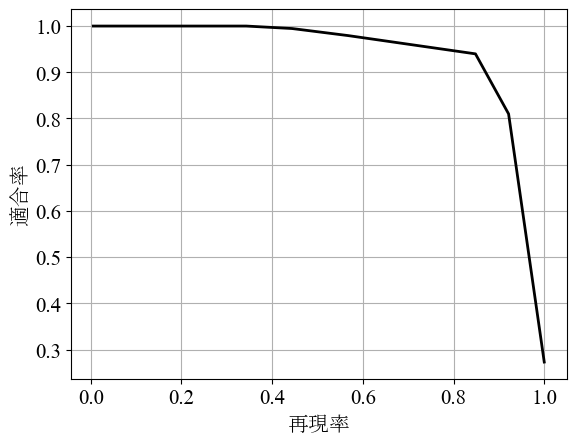

AUC：0.9359438607624431
理想の閾値：0.08
F値（最高）：0.8917245452041769
適合率（最高）：0.9398168338421282
再現率（最高）：0.848314606741573


In [272]:
thr_bins=20
p_score, r_score, f_score, thresholds, thr, auc = fig_pr(test_v, d_test, thr_bins)
print('\033[31m'+f'AUC：{auc}'+'\033[0m')
print(f'理想の閾値：{thr}')
print(f'F値（最高）：{f_score.max()}')
print(f'適合率（最高）：{p_score[np.argmax(f_score)]}')
print(f'再現率（最高）：{r_score[np.argmax(f_score)]}')

In [265]:
p, r=validate(test_v, d_test, thr)
print(f'適合率：{p}')
print(f'再現率：{r}')

適合率：0.9226294357184409
再現率：0.7359550561797753


In [277]:
semi_train_df[semi_train_df['lofed']==1]

,original,day,pred,label,scaned,lofed,svded,svd_label
53,55.9,0,0.0,0,-1,1.0,0.000026,0.0
54,55.5,0,0.0,0,-1,1.0,0.000129,0.0
55,55.5,0,0.0,0,-1,1.0,0.000125,0.0
83,55.1,0,0.0,0,-1,1.0,0.000034,0.0
85,57.0,0,0.0,0,-1,1.0,0.000027,0.0
...,...,...,...,...,...,...,...,...
2393347,48.8,5,0.0,0,-1,1.0,0.001514,0.0
2393348,46.5,5,0.0,0,-1,1.0,0.002149,0.0
2393349,45.5,5,0.0,0,-1,1.0,0.003106,1.0
2393350,45.2,5,0.0,0,-1,1.0,0.003197,1.0


In [276]:
semi_train_df

,original,day,pred,label,scaned,lofed,svded,svd_label
0,53.6,0,0.0,0,0,0.0,0.000000,0.0
1,54.0,0,0.0,0,0,0.0,0.000000,0.0
2,54.7,0,0.0,0,0,0.0,0.000000,0.0
3,55.7,0,0.0,0,-1,0.0,0.000000,0.0
4,55.5,0,0.0,0,-1,0.0,0.000000,0.0
...,...,...,...,...,...,...,...,...
2393381,45.0,5,0.0,0,0,0.0,0.000031,0.0
2393382,45.2,5,0.0,0,0,0.0,0.000025,0.0
2393383,45.1,5,0.0,0,0,0.0,0.000026,0.0
2393384,45.1,5,0.0,0,0,0.0,0.000019,0.0


In [279]:
check_day=3
check_test_v=semi_train_df.loc[semi_train_df.loc[semi_train_df['day']==check_day].index, ['original','day', 'label','pred', 'scaned', 'lofed', 'svded', 'svd_label']]
check_test_v.loc[:, 'dbs']=0
check_test_v.loc[check_test_v['scaned']==0, 'dbs']=1
check_test_v.loc[:, 'd']=check_test_v['svded']/check_test_v['svded'].max()
check_test_v.loc[:, 'd']=check_test_v['svd_label']
check_d_test=check_test_v['d'].values
check_test_v=figure(check_test_v, check_d_test, thr)

In [280]:
check_day=7
check_test_v=test_v.iloc[test.loc[test['day']==check_day].index, :]
check_d_test=check_test_v['d'].values

In [274]:
check_test_v=figure(check_test_v, check_d_test, thr)

# 計量学習(マージン最大化近傍法)

行列Aを使って、2つの標本間の距離を
$$ d^2_A(\boldsymbol{x}',\boldsymbol{x}'')=(\boldsymbol{x}'-\boldsymbol{x}'')^TA(\boldsymbol{x}'-\boldsymbol{x}'')
$$
* 行列Aが分散共分散（の逆行列）のとき、マハラノビス距離
* 行列Aが単位行列のときユークリッド距離
* 行列AがM×Mの半正定値行列として(任意の実ベクトルxに対して内積(x⊤ Ax)>0が成り立つ実対象行列)、最適な行列Aをデータから学習する手法を計量学習。マージン最大化近傍法は以下の最適化問題を解く
    + 同一ラベルに属する標本をなるべく密集させること
    + 異なるラベルに属する標本をできる限り引き離すこと

In [51]:
print(f'訓練データ（学習用）：{semi_train_day}日目')
print(f'テストデータ（最終評価用）：{test_day}日目')
metric_learn_w=7

df_list=[]
df_list=[]
for i in semi_train_day:
    lag=[] 
    lag.append(make_data(semi_train_df.loc[semi_train_df['day']==i, ['original']], 'original', metric_learn_w))
    lag.append(semi_train_df.loc[semi_train_df['day']==i, ['day', 'pred', 'scaned', 'label']])
    df_add_lag=pd.concat(lag, axis=1)
    df_list.append(df_add_lag)
semi_train=pd.concat(df_list)
semi_train=semi_train.dropna().reset_index(drop=True)
semi_train

訓練データ（学習用）：[0, 1, 2, 3, 4, 5]日目
テストデータ（最終評価用）：[6, 7, 8, 9]日目


,original,original_lag1,original_lag2,original_lag3,original_lag4,original_lag5,original_lag6,day,pred,scaned,label
0,55.6,55.7,55.5,55.7,54.7,54.0,53.6,0,0.0,0,0
1,55.8,55.6,55.7,55.5,55.7,54.7,54.0,0,0.0,0,0
2,55.7,55.8,55.6,55.7,55.5,55.7,54.7,0,0.0,0,0
3,55.0,55.7,55.8,55.6,55.7,55.5,55.7,0,0.0,0,0
4,54.9,55.0,55.7,55.8,55.6,55.7,55.5,0,0.0,0,0
...,...,...,...,...,...,...,...,...,...,...,...
2393345,45.0,45.4,45.1,44.8,45.4,45.6,45.0,5,0.0,0,0
2393346,45.2,45.0,45.4,45.1,44.8,45.4,45.6,5,0.0,0,0
2393347,45.1,45.2,45.0,45.4,45.1,44.8,45.4,5,0.0,0,0
2393348,45.1,45.1,45.2,45.0,45.4,45.1,44.8,5,0.0,0,0


In [53]:
# ほぼ確実に正常なデータ
semi_train_0=semi_train[(semi_train['scaned']==0)]
# ほぼ確実に異常なデータ
semi_train_1=semi_train[(semi_train['pred']==1)]

### データ数が多すぎて処理時間が長いためとりあえずダウンサンプリング

In [55]:
# 正常データを系統抽出でダウンサンプリング（自己一致を避けるため）
step=math.floor(len(semi_train_0)/len(semi_train_1))
step=math.floor(step/10)
sampling_idx=np.arange(0, len(semi_train_0), step)
semi_train_0_DS=semi_train_0.iloc[sampling_idx, :]
semi_train_DS=pd.concat([semi_train_0_DS, semi_train_1])

train_x=semi_train_DS[semi_train_DS.columns[:-4]].values
train_y=semi_train_DS[semi_train_DS.columns[-1]].values

In [56]:
df_list=[]
for i in test_day:
    lag=[] 
    lag.append(make_data(test_df.loc[test_df['day']==i, ['original']], 'original', metric_learn_w))
    lag.append(test_df.loc[test_df['day']==i, ['day', 'label']])
    df_add_lag=pd.concat(lag, axis=1)
    df_list.append(df_add_lag)
test=pd.concat(df_list)
test=test.dropna().reset_index(drop=True)

test_x=test[test.columns[:-2]].values
test_y=test[test.columns[-1]].values

In [73]:
test

,original,original_lag1,original_lag2,original_lag3,original_lag4,original_lag5,original_lag6,day,label
0,45.6,45.3,45.3,45.7,45.8,45.4,45.4,6,0
1,45.6,45.6,45.3,45.3,45.7,45.8,45.4,6,0
2,45.5,45.6,45.6,45.3,45.3,45.7,45.8,6,0
3,45.9,45.5,45.6,45.6,45.3,45.3,45.7,6,0
4,45.9,45.9,45.5,45.6,45.6,45.3,45.3,6,0
...,...,...,...,...,...,...,...,...,...
1601911,45.9,45.6,45.4,45.9,46.0,45.7,45.4,9,0
1601912,45.6,45.9,45.6,45.4,45.9,46.0,45.7,9,0
1601913,45.8,45.6,45.9,45.6,45.4,45.9,46.0,9,0
1601914,45.7,45.8,45.6,45.9,45.6,45.4,45.9,9,0


## 次元削減PCA

In [57]:
pca = PCA(n_components=5)
train_x=pca.fit_transform(train_x) 
test_x=pca.fit_transform(test_x) 

## LMNN

In [58]:
lmnn = metric_learn.LMNN(k=6, learn_rate=1e-6)

C:\Users\g1972\anaconda3\envs\lmnn\Lib\site-packages\metric_learn\lmnn.py:140: FutureWarning: "num_chunks" parameter has been renamed to "n_chunks". It has been deprecated in version 0.6.3 and will be removed in 0.7.0
  warnings.warn('"num_chunks" parameter has been renamed to'


In [59]:
lmnn.fit(train_x, train_y)

LMNN(learn_rate=1e-06, n_neighbors=6)

In [60]:
train_x_lmnn=lmnn.transform(train_x)
test_x_lmnn=lmnn.transform(test_x)

# K近傍法

In [61]:
#処理時間の計測
time_start=time.perf_counter()

nk=best_params['nk']
neigh = NearestNeighbors(n_neighbors=nk)
neigh.fit(train_x_lmnn)
d = neigh.kneighbors(test_x_lmnn)[0]
d = np.mean(d, axis=1)

time_end = time.perf_counter()
processing_time=time_end-time_start
print(f'異常度算出にかかる処理時間：{processing_time}秒')

test_v=test[['original', 'label']].copy().reset_index(drop=True)
test_v['d']=d

#道路交通騒音に埋もれている異常音は正常とする
test_v=leq_filter(test_v)
test_v['d']=test_v['d']/test_v['d'].max()
d_test=test_v['d'].values

test_v['time']=[t * 0.2 / 60 for t in range(len(d_test))]

異常度算出にかかる処理時間：17.28358039999148秒


# PR曲線

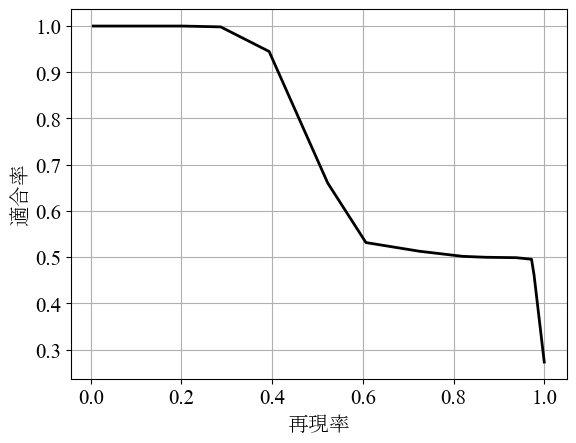

AUC：0.7351461955966422
理想の閾値：0.08
F値（最高）：0.6562190096828328
適合率（最高）：0.49532874308086944
再現率（最高）：0.9719101123595506


In [63]:
thr_bins=20
p_score, r_score, f_score, thresholds, thr, auc = fig_pr(test_v, d_test, thr_bins)
print('\033[31m'+f'AUC：{auc}'+'\033[0m')
print(f'理想の閾値：{thr}')
print(f'F値（最高）：{f_score.max()}')
print(f'適合率（最高）：{p_score[np.argmax(f_score)]}')
print(f'再現率（最高）：{r_score[np.argmax(f_score)]}')

# 異常度可視化

In [64]:
p, r=validate(test_v, d_test, thr)
print(f'適合率：{p}')
print(f'再現率：{r}')

適合率：0.49532874308086944
再現率：0.9719101123595506


In [65]:
test_day

[6, 7, 8, 9]

In [66]:
check_day=7
check_test_v=test_v.iloc[test.loc[test['day']==check_day].index, :]
check_d_test=check_test_v['d'].values

In [67]:
check_test_v=figure(check_test_v, check_d_test, thr)